<a href="https://colab.research.google.com/github/dht7166/x4Resolution/blob/master/Single_Image_SR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://arxiv.org/pdf/1501.00092.pdf
Following that

In [ ]:
import keras
from keras import layers
from keras import models
import tensorflow as tf
import numpy as np
import cv2
import glob
import os
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from keras import backend as K

# The generator


In [ ]:
from keras.utils import Sequence
class Generator(Sequence):
    def __init__(self,images,batch_size,insize = 64,outsize = 240,factor = 4,pretrained = None):
        
        self.image_set = images
        self.batch_size = batch_size
        self.len = int(np.ceil(len(self.image_set)/self.batch_size))
        self.insize = (insize,insize)
        self.model_in = (insize*factor,insize*factor)
        self.start = int((insize*factor-outsize)/2)
        self.end = self.start+outsize
        self.pretrained = pretrained
        
    def __len__(self):
        return int(self.len)

    def __getitem__(self, idx):
        y = []
        x = []
        current_list = self.image_set[int(idx * self.batch_size): int((idx + 1) * self.batch_size)]
        for img in current_list:
            image = cv2.imread(img)
            in_image = cv2.resize(image,self.insize)
            in_image = cv2.resize(in_image,self.model_in)
            out_image = cv2.resize(image,self.model_in)
            out_image = out_image[self.start:self.end,self.start:self.end,:]
            x.append(in_image.astype(np.float32))
            y.append(out_image.astype(np.float32))
        
        x = np.asarray(x)
        y = np.asarray(y)
        if self.pretrained is not None:
            outputs = self.pretrained(y)
            # y = {}
            # for i,layer in enumerate(pretrained_multi_output.output_names):
            #     y[layer] = outputs[i]
            y = outputs

        return x/255.0,y/255.0

# Using mobile net for perceptual loss

Could also try out Xception or the more standard VGG16, although it is quite huge

In [ ]:
from keras.applications import MobileNet

pretrained = MobileNet(input_shape = (None,None,3),
                       include_top = False,
                       weights = 'imagenet')

layer_for_perception_loss = [4,7,14,67,-1] # mobilenet layers

pretrained_multi_output = models.Model(pretrained.input,outputs = [pretrained.layers[i].output for i in layer_for_perception_loss],name = 'perception')
pretrained_multi_output.trainable = False


def percep_loss(y_true,y_pred):
    c_true = pretrained_multi_output(y_true)
    c_pred = pretrained_multi_output(y_pred)
    loss = 0
    for p,t in zip(c_true,c_pred):
        loss+=K.mean(K.square(p-t))
    return loss

17227776/17225924 [==============================] - 0s 0us/step


# The model


In [ ]:
class SuperResolution:
    def __init__(self,n1,f1,n2,f2,f3,pretrained = None):
        self.model = self.create_model(n1,f1,n2,f2,f3)
        if pretrained!=None:
            inp = layers.Input(shape = (None,None,3),name = 'SR_input')
            out = self.model(inp)
            percep_out = pretrained(out)
            self.model_w_percep = models.Model(inp,outputs = [out,percep_out],name = "SR_w_percep")

    def create_patch(self,n,f,name,tensor):
        x = layers.Conv2D(filters=n,kernel_size=(f,f),name = name,
                          padding='valid',use_bias=True)(tensor)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU(alpha=0.1)(x)
        return x

    def create_model(self,n1,f1,n2,f2,f3):
        inp = layers.Input(shape = (None,None,3)) # input

        x = self.create_patch(n1,f1,'patch_extraction',inp)

        x = self.create_patch(n2,f2,'nonlinear_mapping',x)

        # reconstruction needs none of the relu stuff
        out = layers.Conv2D(filters=3,kernel_size=(f3,f3),name ='reconstruction',
                          padding='valid',use_bias=True)(x)

        out = K.sigmoid(out)

        return models.Model(inp,out,name = "SR")

# The training

In [ ]:
from keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau,LambdaCallback
from keras.optimizers import Adam


# Some model settings
f1 = 9
f2 = 5
f3 = 5
learn_rate = 0.001
decay_plateau = 0.5

# The model
SR = SuperResolution(n1 = 64,f1 = f1,
                     n2 = 32, f2 = f2,
                     f3 = f3)
optimizer = Adam(lr = learn_rate)
SR.model.compile(loss = percep_loss,optimizer=optimizer)


# The generator
img_list = glob.glob('/content/drive/My Drive/Single_Image_SR/afhq/train/*/*.jpg')
# lvl1 generator
train_3 = Generator(img_list,32,
                    insize = 64,
                    outsize = 64*4 -f1-f2-f3+3,
                    factor = 4)

Epoch 25/100
458/458 [==============================] - ETA: 0s - loss: 2.7189

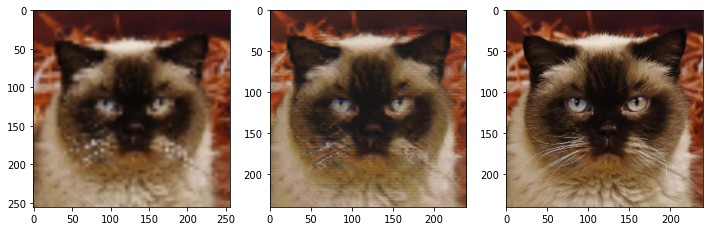

458/458 [==============================] - 195s 426ms/step - loss: 2.7189
Epoch 26/100
458/458 [==============================] - ETA: 0s - loss: 2.7139

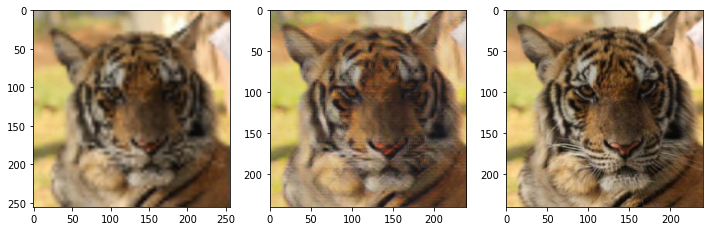

458/458 [==============================] - 195s 425ms/step - loss: 2.7139
Epoch 27/100
458/458 [==============================] - ETA: 0s - loss: 2.7110

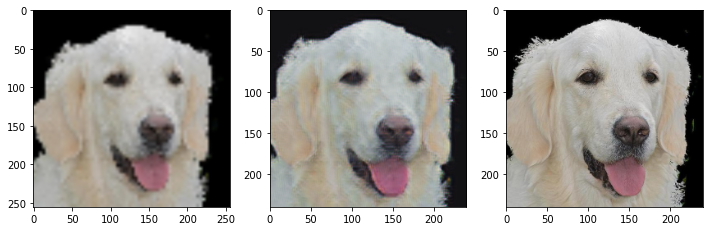

458/458 [==============================] - 195s 425ms/step - loss: 2.7110
Epoch 28/100
458/458 [==============================] - ETA: 0s - loss: 2.7085

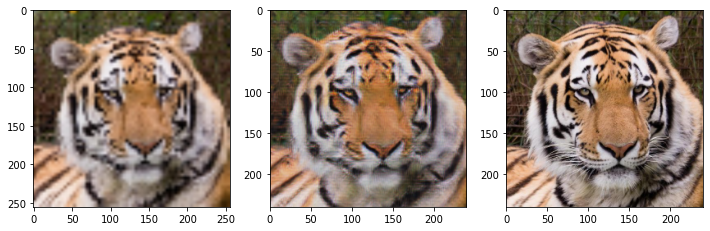

458/458 [==============================] - 195s 425ms/step - loss: 2.7085
Epoch 29/100
458/458 [==============================] - ETA: 0s - loss: 2.7035

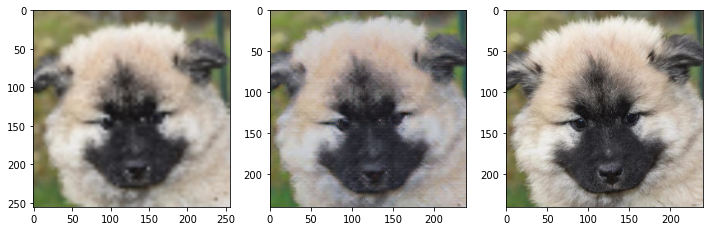

458/458 [==============================] - 195s 425ms/step - loss: 2.7035
Epoch 30/100
458/458 [==============================] - ETA: 0s - loss: 2.6968

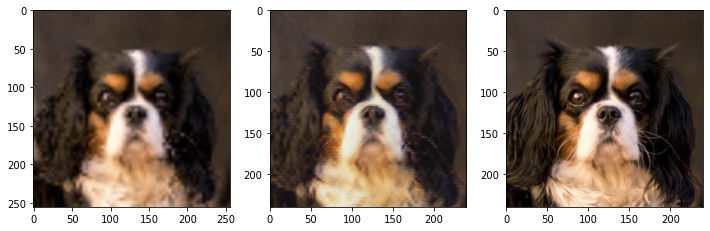

458/458 [==============================] - 195s 425ms/step - loss: 2.6968
Epoch 31/100
458/458 [==============================] - ETA: 0s - loss: 2.6966

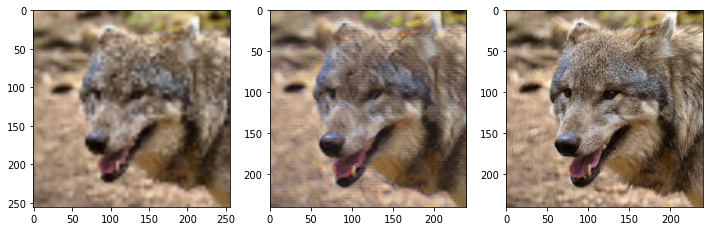

458/458 [==============================] - 195s 425ms/step - loss: 2.6966
Epoch 32/100
458/458 [==============================] - ETA: 0s - loss: 2.6877

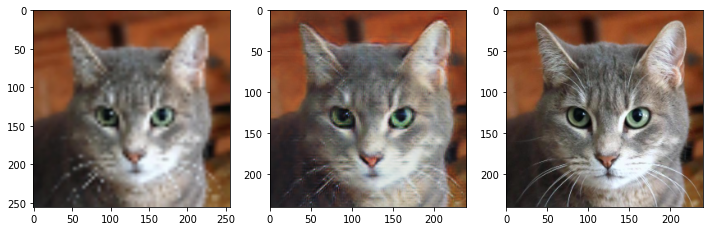

458/458 [==============================] - 195s 425ms/step - loss: 2.6877
Epoch 33/100
458/458 [==============================] - ETA: 0s - loss: 2.6859

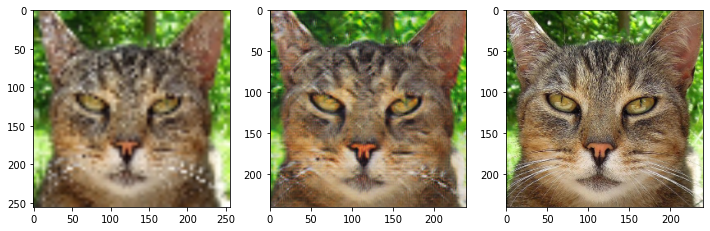

458/458 [==============================] - 195s 425ms/step - loss: 2.6859
Epoch 34/100
458/458 [==============================] - ETA: 0s - loss: 2.6825

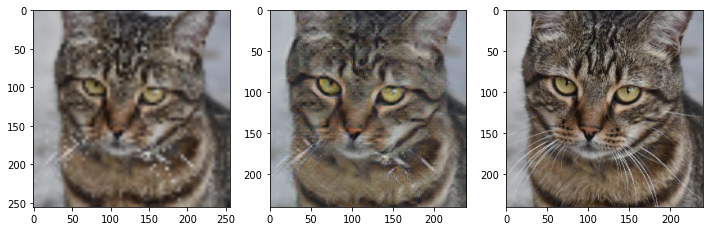

458/458 [==============================] - 194s 424ms/step - loss: 2.6825
Epoch 35/100
458/458 [==============================] - ETA: 0s - loss: 2.6804

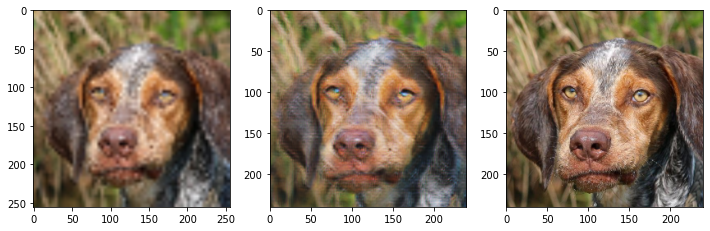

458/458 [==============================] - 195s 425ms/step - loss: 2.6804
Epoch 36/100
458/458 [==============================] - ETA: 0s - loss: 2.6779

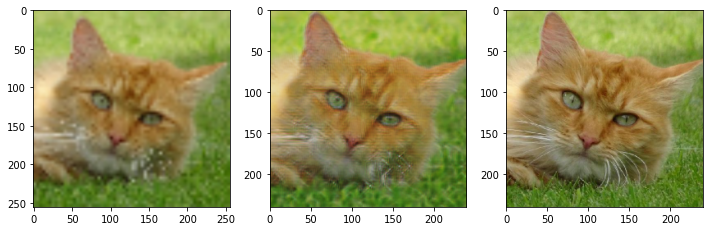

458/458 [==============================] - 195s 425ms/step - loss: 2.6779
Epoch 37/100
458/458 [==============================] - ETA: 0s - loss: 2.6699

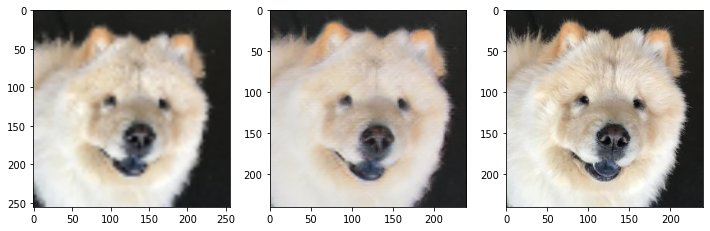

458/458 [==============================] - 194s 425ms/step - loss: 2.6699
Epoch 38/100
458/458 [==============================] - ETA: 0s - loss: 2.6684

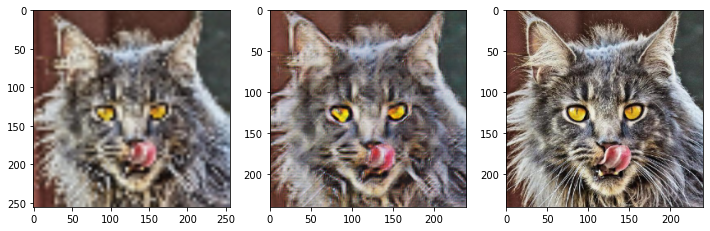

458/458 [==============================] - 195s 425ms/step - loss: 2.6684
Epoch 39/100
458/458 [==============================] - ETA: 0s - loss: 2.6646

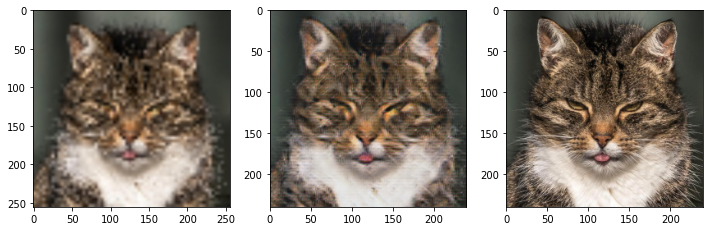

458/458 [==============================] - 195s 425ms/step - loss: 2.6646
Epoch 40/100
458/458 [==============================] - ETA: 0s - loss: 2.6598

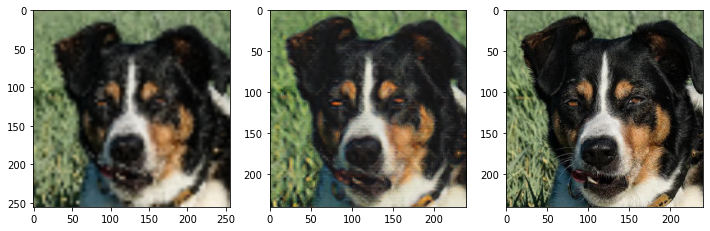

458/458 [==============================] - 194s 425ms/step - loss: 2.6598
Epoch 41/100
458/458 [==============================] - ETA: 0s - loss: 2.6576

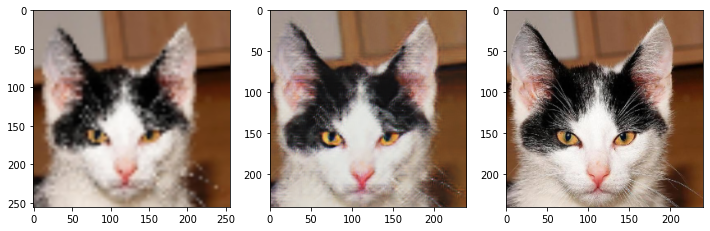

458/458 [==============================] - 194s 424ms/step - loss: 2.6576
Epoch 42/100
458/458 [==============================] - ETA: 0s - loss: 2.6560

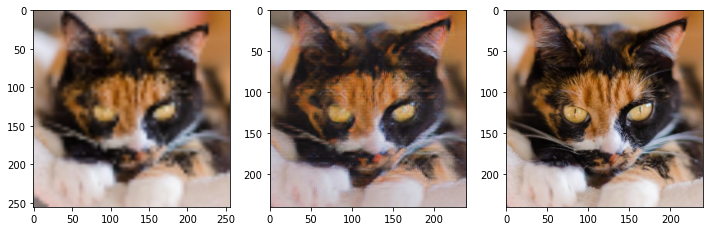

458/458 [==============================] - 194s 424ms/step - loss: 2.6560
Epoch 43/100
458/458 [==============================] - ETA: 0s - loss: 2.6516

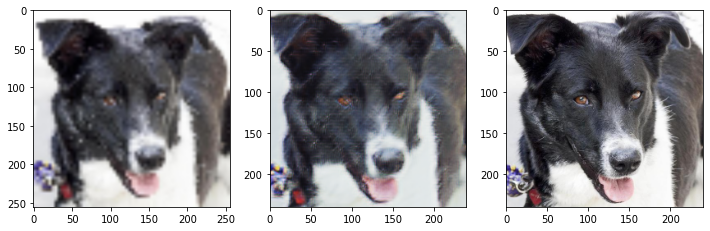

458/458 [==============================] - 195s 425ms/step - loss: 2.6516
Epoch 44/100
458/458 [==============================] - ETA: 0s - loss: 2.6504

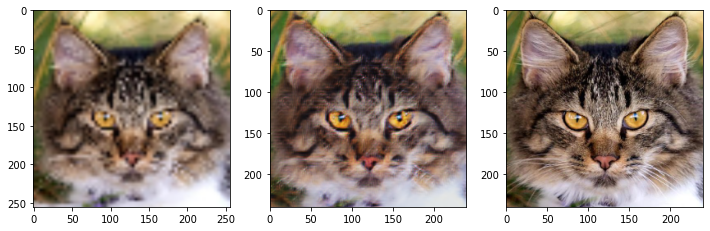

458/458 [==============================] - 194s 424ms/step - loss: 2.6504
Epoch 45/100
458/458 [==============================] - ETA: 0s - loss: 2.6442

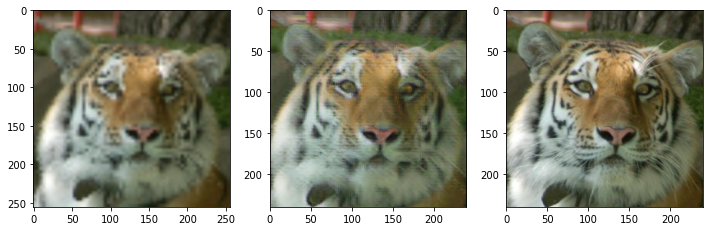

458/458 [==============================] - 195s 425ms/step - loss: 2.6442
Epoch 46/100
458/458 [==============================] - ETA: 0s - loss: 2.6430

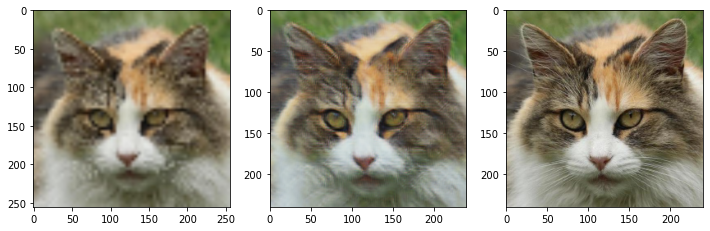

458/458 [==============================] - 195s 426ms/step - loss: 2.6430
Epoch 47/100
458/458 [==============================] - ETA: 0s - loss: 2.6415

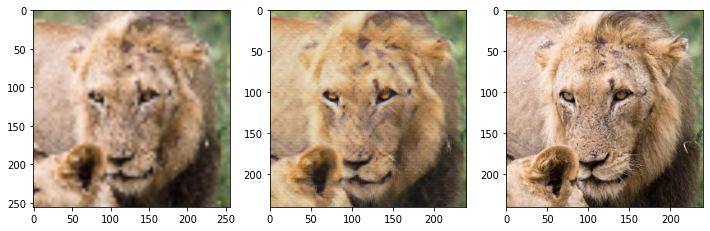

458/458 [==============================] - 195s 425ms/step - loss: 2.6415
Epoch 48/100
458/458 [==============================] - ETA: 0s - loss: 2.6354

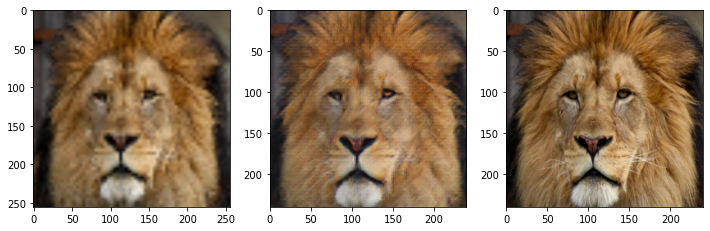

458/458 [==============================] - 195s 425ms/step - loss: 2.6354
Epoch 49/100
458/458 [==============================] - ETA: 0s - loss: 2.6351

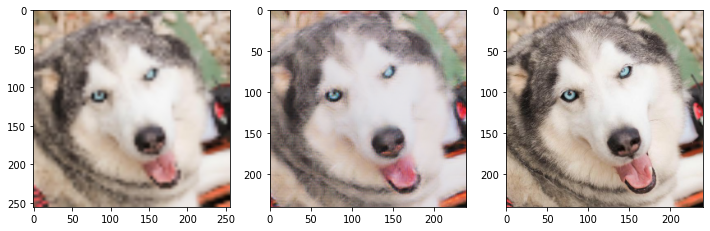

458/458 [==============================] - 195s 425ms/step - loss: 2.6351
Epoch 50/100
458/458 [==============================] - ETA: 0s - loss: 2.6321

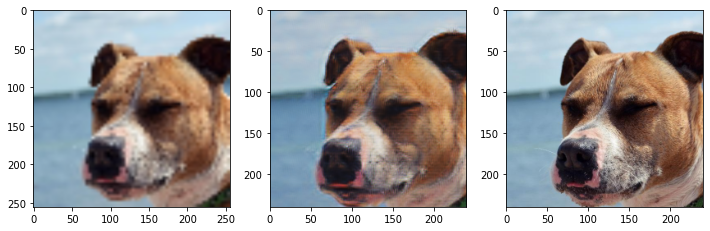

458/458 [==============================] - 195s 426ms/step - loss: 2.6321
Epoch 51/100
458/458 [==============================] - ETA: 0s - loss: 2.6283

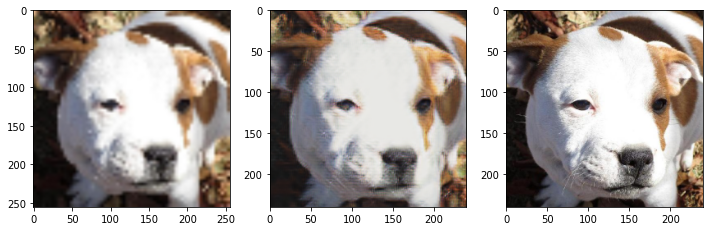

458/458 [==============================] - 195s 425ms/step - loss: 2.6283
Epoch 52/100
458/458 [==============================] - ETA: 0s - loss: 2.6280

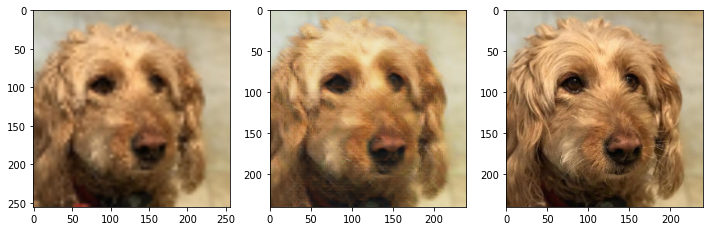

458/458 [==============================] - 195s 425ms/step - loss: 2.6280
Epoch 53/100
458/458 [==============================] - ETA: 0s - loss: 2.6230

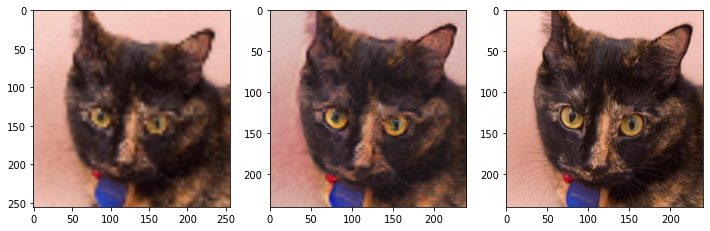

458/458 [==============================] - 195s 425ms/step - loss: 2.6230
Epoch 54/100
458/458 [==============================] - ETA: 0s - loss: 2.6196

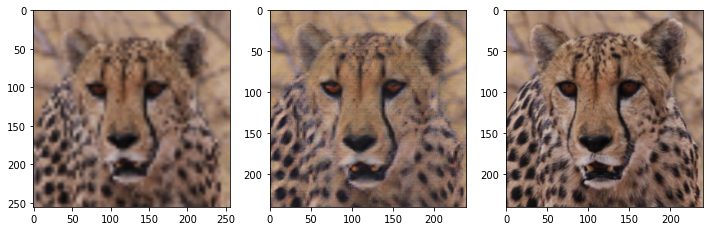

458/458 [==============================] - 194s 424ms/step - loss: 2.6196
Epoch 55/100
458/458 [==============================] - ETA: 0s - loss: 2.6195
Epoch 00055: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-05.


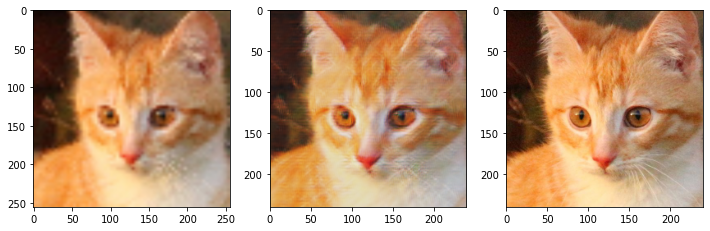

458/458 [==============================] - 195s 425ms/step - loss: 2.6195
Epoch 56/100
458/458 [==============================] - ETA: 0s - loss: 2.5974

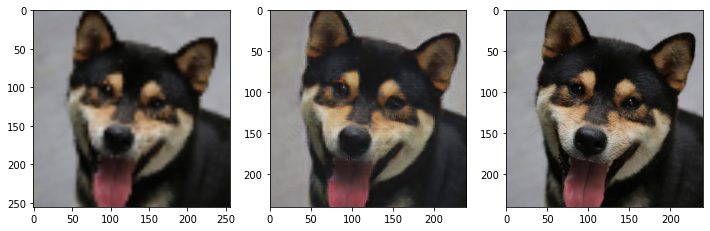

458/458 [==============================] - 194s 424ms/step - loss: 2.5974
Epoch 57/100
458/458 [==============================] - ETA: 0s - loss: 2.5958

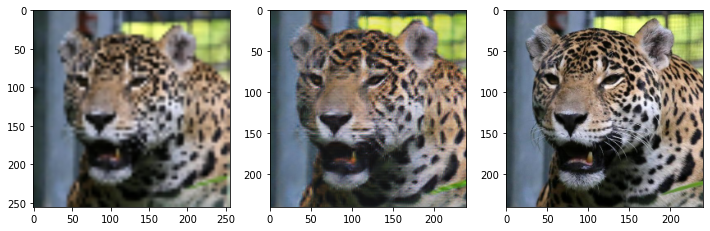

458/458 [==============================] - 194s 424ms/step - loss: 2.5958
Epoch 58/100
458/458 [==============================] - ETA: 0s - loss: 2.5939

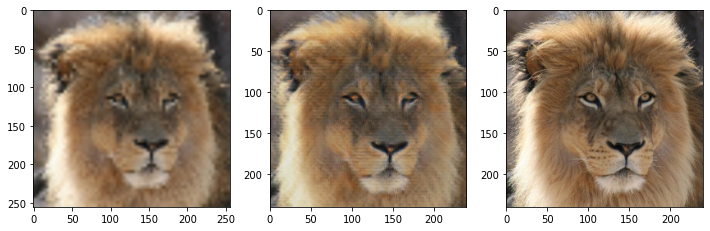

458/458 [==============================] - 194s 424ms/step - loss: 2.5939
Epoch 59/100
458/458 [==============================] - ETA: 0s - loss: 2.5935

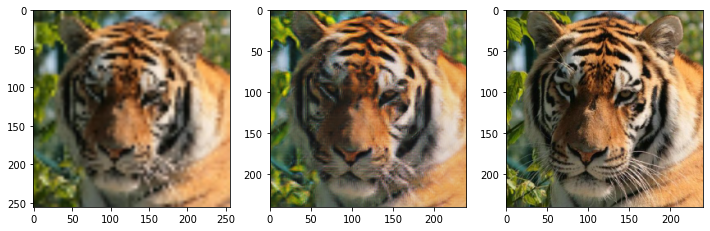

458/458 [==============================] - 195s 425ms/step - loss: 2.5935
Epoch 60/100
458/458 [==============================] - ETA: 0s - loss: 2.5907

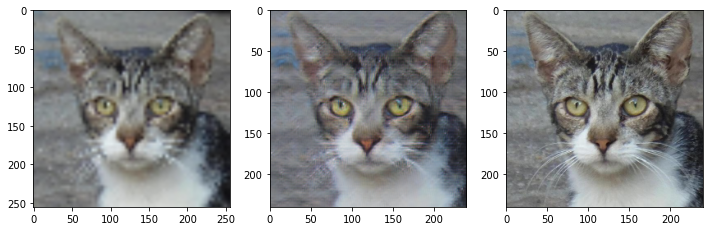

458/458 [==============================] - 195s 425ms/step - loss: 2.5907
Epoch 61/100
458/458 [==============================] - ETA: 0s - loss: 2.5896

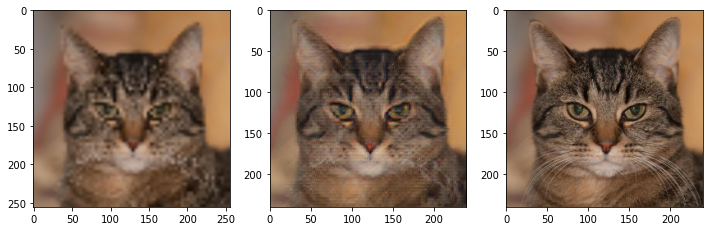

458/458 [==============================] - 194s 425ms/step - loss: 2.5896
Epoch 62/100
458/458 [==============================] - ETA: 0s - loss: 2.5898
Epoch 00062: ReduceLROnPlateau reducing learning rate to 2.499999936844688e-05.


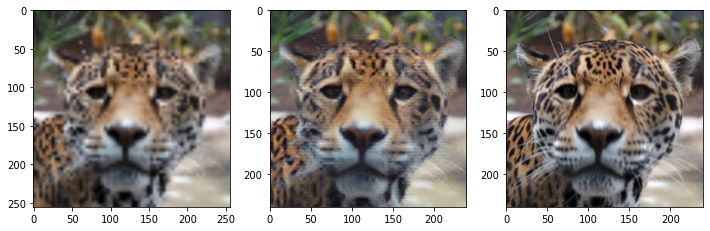

458/458 [==============================] - 194s 423ms/step - loss: 2.5898
Epoch 63/100
458/458 [==============================] - ETA: 0s - loss: 2.5765

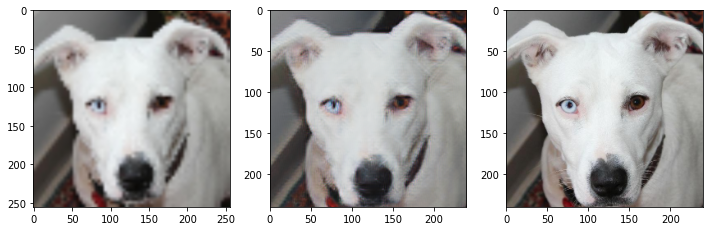

458/458 [==============================] - 195s 425ms/step - loss: 2.5765
Epoch 64/100
458/458 [==============================] - ETA: 0s - loss: 2.5752

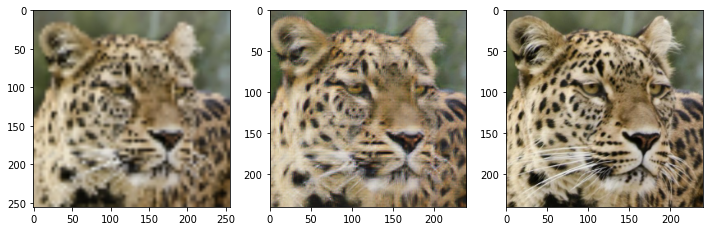

458/458 [==============================] - 195s 426ms/step - loss: 2.5752
Epoch 65/100
458/458 [==============================] - ETA: 0s - loss: 2.5746

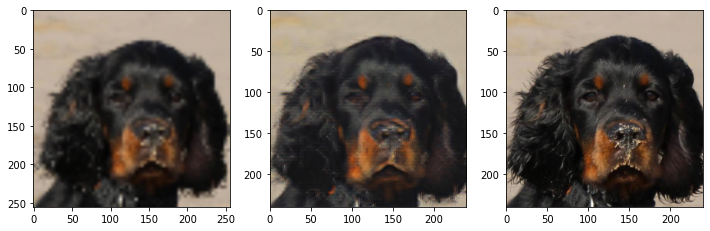

458/458 [==============================] - 195s 425ms/step - loss: 2.5746
Epoch 66/100
458/458 [==============================] - ETA: 0s - loss: 2.5742

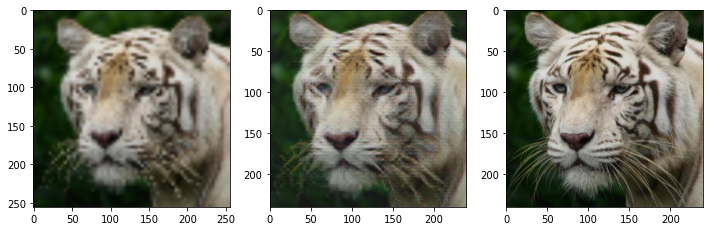

458/458 [==============================] - 198s 433ms/step - loss: 2.5742
Epoch 67/100
458/458 [==============================] - ETA: 0s - loss: 2.5734

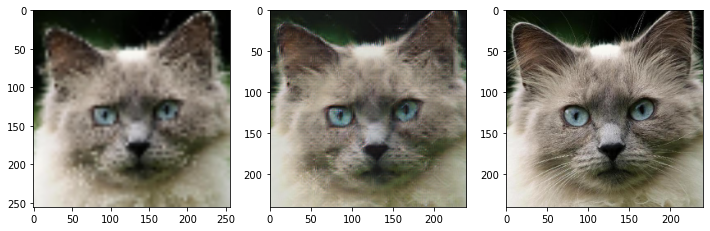

458/458 [==============================] - 194s 424ms/step - loss: 2.5734
Epoch 68/100
458/458 [==============================] - ETA: 0s - loss: 2.5723

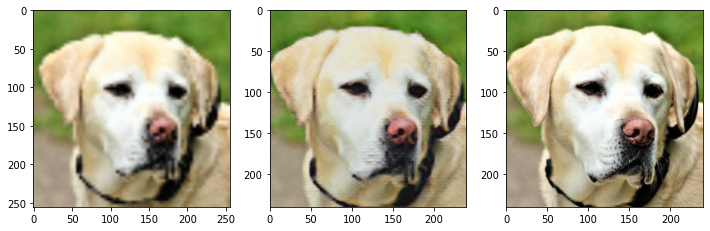

458/458 [==============================] - 195s 425ms/step - loss: 2.5723
Epoch 69/100
458/458 [==============================] - ETA: 0s - loss: 2.5712

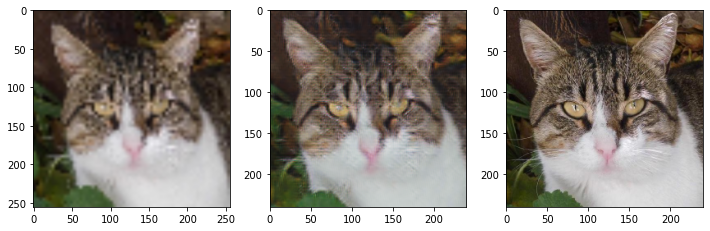

458/458 [==============================] - 194s 424ms/step - loss: 2.5712
Epoch 70/100
458/458 [==============================] - ETA: 0s - loss: 2.5711

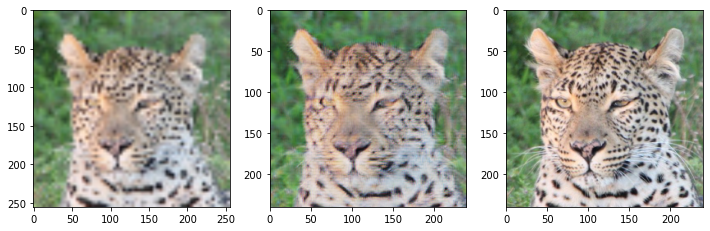

458/458 [==============================] - 195s 425ms/step - loss: 2.5711
Epoch 71/100
458/458 [==============================] - ETA: 0s - loss: 2.5701

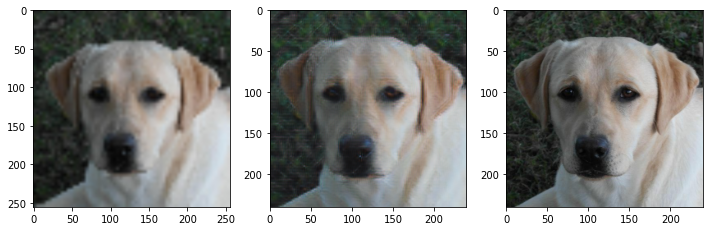

458/458 [==============================] - 193s 420ms/step - loss: 2.5701
Epoch 72/100
458/458 [==============================] - ETA: 0s - loss: 2.5691

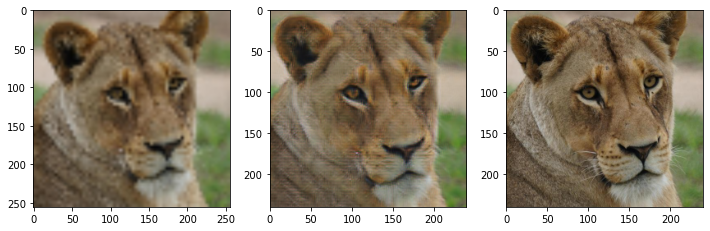

458/458 [==============================] - 192s 419ms/step - loss: 2.5691
Epoch 73/100
458/458 [==============================] - ETA: 0s - loss: 2.5683

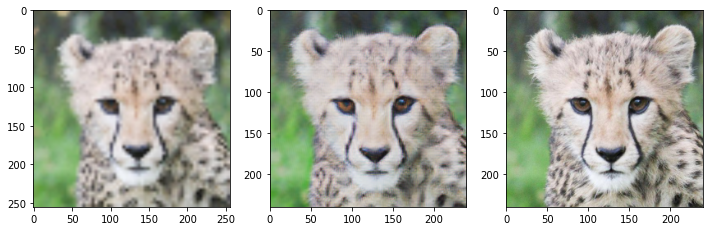

458/458 [==============================] - 192s 420ms/step - loss: 2.5683
Epoch 74/100
458/458 [==============================] - ETA: 0s - loss: 2.5685
Epoch 00074: ReduceLROnPlateau reducing learning rate to 1.249999968422344e-05.


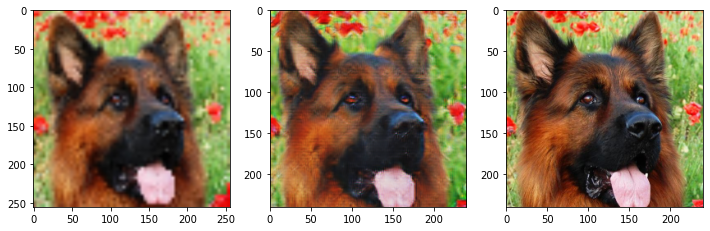

458/458 [==============================] - 194s 423ms/step - loss: 2.5685
Epoch 75/100
458/458 [==============================] - ETA: 0s - loss: 2.5622

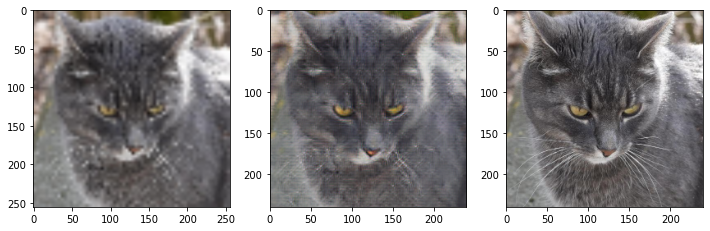

458/458 [==============================] - 194s 423ms/step - loss: 2.5622
Epoch 76/100
458/458 [==============================] - ETA: 0s - loss: 2.5612

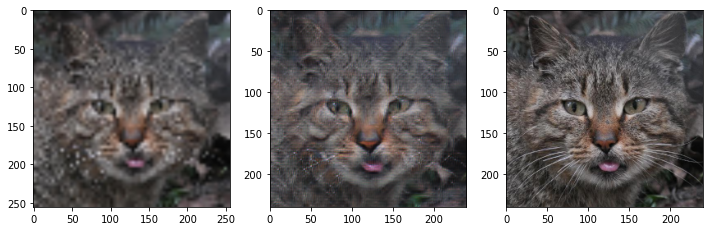

458/458 [==============================] - 192s 420ms/step - loss: 2.5612
Epoch 77/100
458/458 [==============================] - ETA: 0s - loss: 2.5608

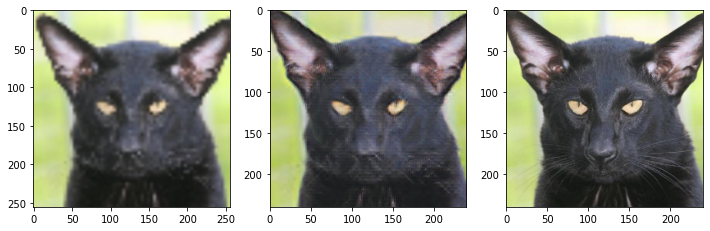

458/458 [==============================] - 192s 419ms/step - loss: 2.5608
Epoch 78/100
458/458 [==============================] - ETA: 0s - loss: 2.5604

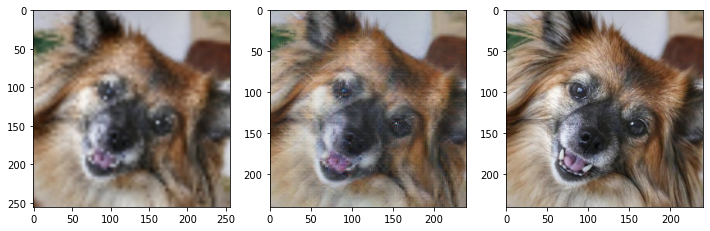

458/458 [==============================] - 194s 423ms/step - loss: 2.5604
Epoch 79/100
458/458 [==============================] - ETA: 0s - loss: 2.5599

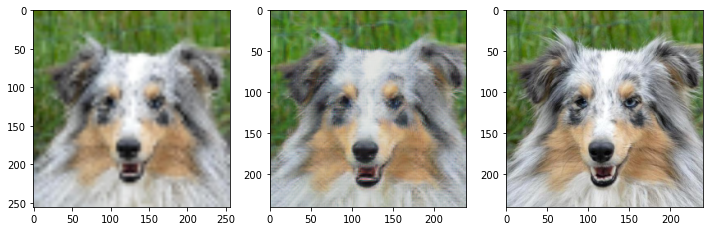

458/458 [==============================] - 194s 424ms/step - loss: 2.5599
Epoch 80/100
458/458 [==============================] - ETA: 0s - loss: 2.5596

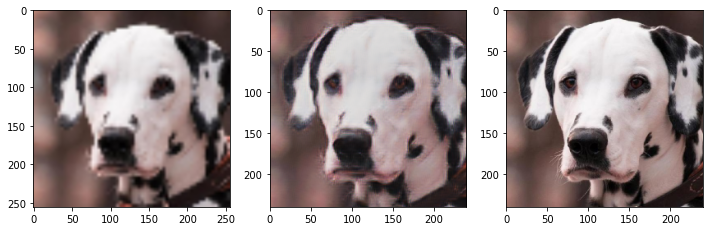

458/458 [==============================] - 192s 419ms/step - loss: 2.5596
Epoch 81/100
458/458 [==============================] - ETA: 0s - loss: 2.5594

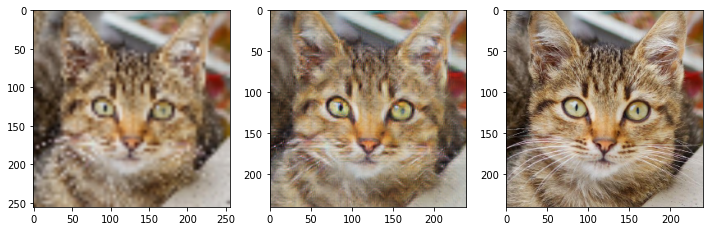

458/458 [==============================] - 192s 418ms/step - loss: 2.5594
Epoch 82/100
458/458 [==============================] - ETA: 0s - loss: 2.5586

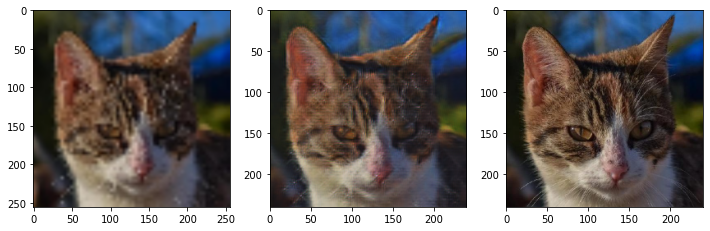

458/458 [==============================] - 192s 419ms/step - loss: 2.5586
Epoch 83/100
458/458 [==============================] - ETA: 0s - loss: 2.5588
Epoch 00083: ReduceLROnPlateau reducing learning rate to 6.24999984211172e-06.


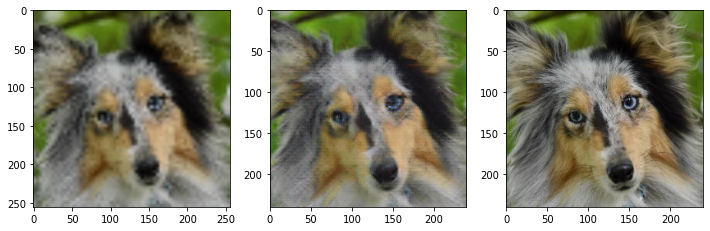

458/458 [==============================] - 194s 423ms/step - loss: 2.5588
Epoch 84/100
458/458 [==============================] - ETA: 0s - loss: 2.5554

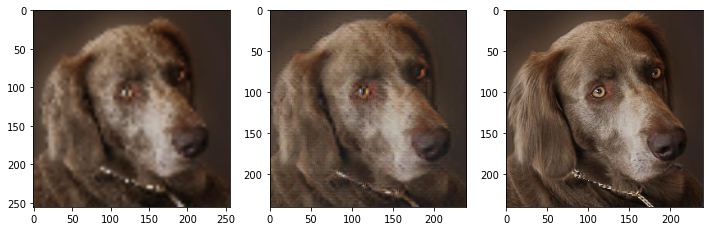

458/458 [==============================] - 193s 421ms/step - loss: 2.5554
Epoch 85/100
458/458 [==============================] - ETA: 0s - loss: 2.5550

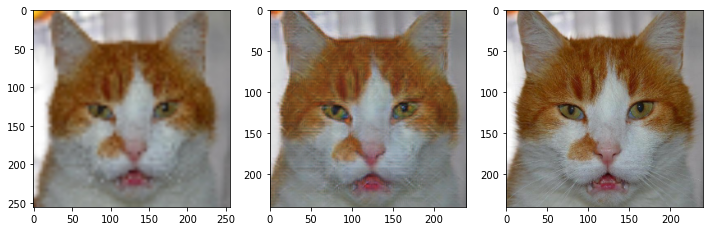

458/458 [==============================] - 191s 418ms/step - loss: 2.5550
Epoch 86/100
458/458 [==============================] - ETA: 0s - loss: 2.5548

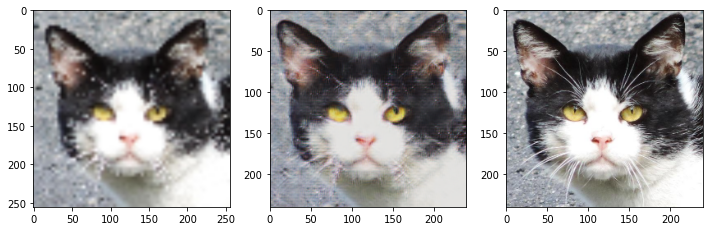

458/458 [==============================] - 192s 419ms/step - loss: 2.5548
Epoch 87/100
458/458 [==============================] - ETA: 0s - loss: 2.5544

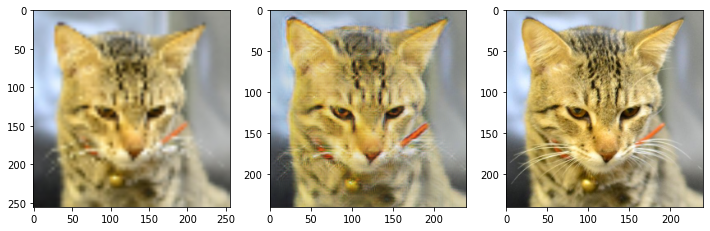

458/458 [==============================] - 192s 420ms/step - loss: 2.5544
Epoch 88/100
458/458 [==============================] - ETA: 0s - loss: 2.5547
Epoch 00088: ReduceLROnPlateau reducing learning rate to 3.12499992105586e-06.


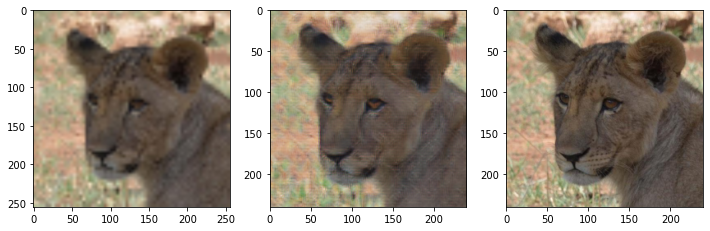

458/458 [==============================] - 194s 423ms/step - loss: 2.5547
Epoch 89/100
458/458 [==============================] - ETA: 0s - loss: 2.5526

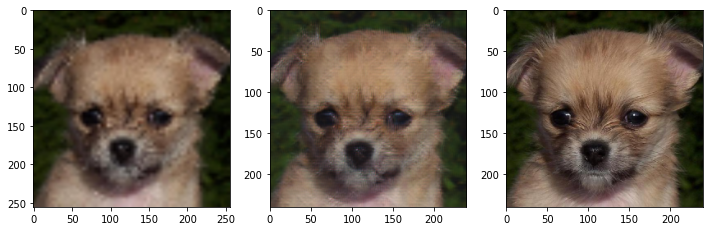

458/458 [==============================] - 194s 424ms/step - loss: 2.5526
Epoch 90/100
458/458 [==============================] - ETA: 0s - loss: 2.5525
Epoch 00090: ReduceLROnPlateau reducing learning rate to 1.56249996052793e-06.


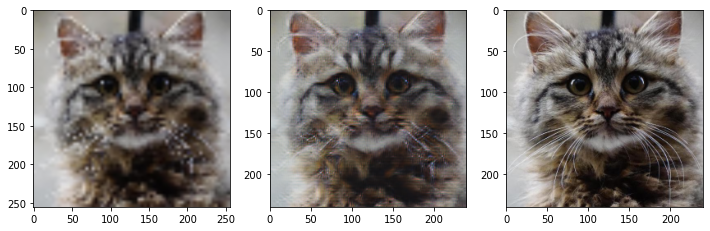

458/458 [==============================] - 192s 419ms/step - loss: 2.5525
Epoch 91/100
458/458 [==============================] - ETA: 0s - loss: 2.5517

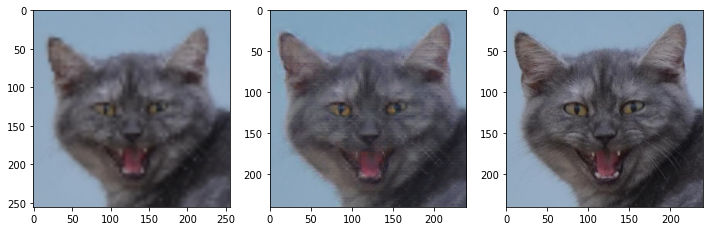

458/458 [==============================] - 192s 418ms/step - loss: 2.5517
Epoch 92/100
458/458 [==============================] - ETA: 0s - loss: 2.5515

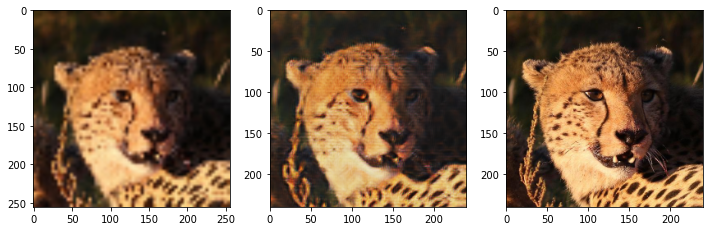

458/458 [==============================] - 193s 422ms/step - loss: 2.5515
Epoch 93/100
458/458 [==============================] - ETA: 0s - loss: 2.5514
Epoch 00093: ReduceLROnPlateau reducing learning rate to 7.81249980263965e-07.


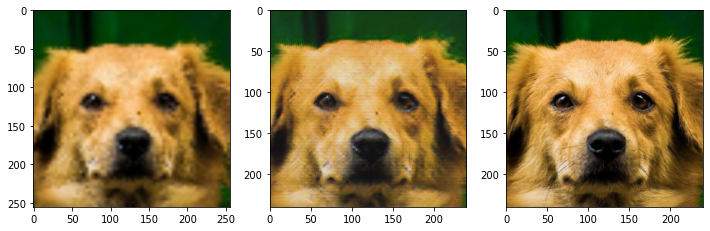

458/458 [==============================] - 195s 425ms/step - loss: 2.5514
Epoch 94/100
458/458 [==============================] - ETA: 0s - loss: 2.5511

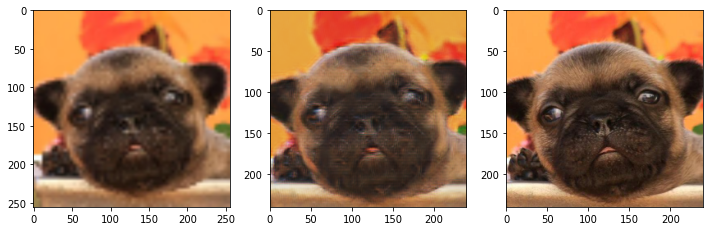

458/458 [==============================] - 193s 422ms/step - loss: 2.5511
Epoch 95/100
458/458 [==============================] - ETA: 0s - loss: 2.5510

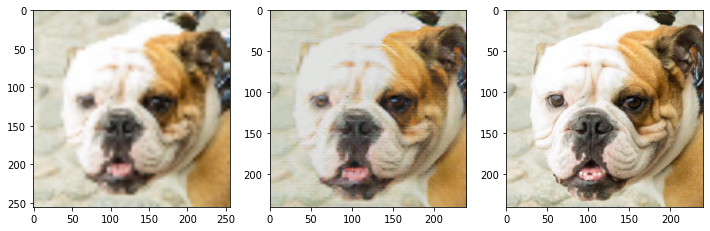

458/458 [==============================] - 192s 420ms/step - loss: 2.5510
Epoch 96/100
458/458 [==============================] - ETA: 0s - loss: 2.5509
Epoch 00096: ReduceLROnPlateau reducing learning rate to 3.906249901319825e-07.


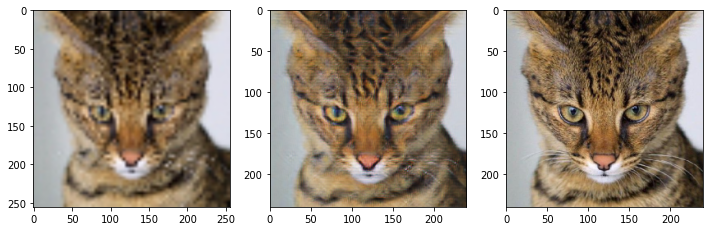

458/458 [==============================] - 191s 418ms/step - loss: 2.5509
Epoch 97/100
458/458 [==============================] - ETA: 0s - loss: 2.5507

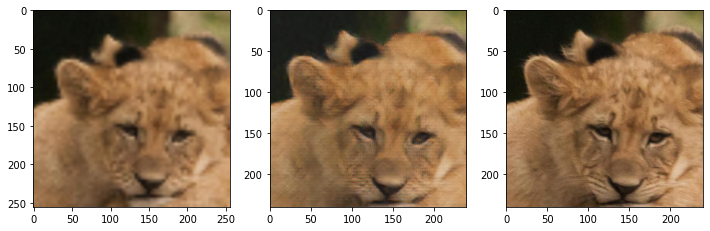

458/458 [==============================] - 194s 424ms/step - loss: 2.5507
Epoch 98/100
458/458 [==============================] - ETA: 0s - loss: 2.5507
Epoch 00098: ReduceLROnPlateau reducing learning rate to 1.9531249506599124e-07.


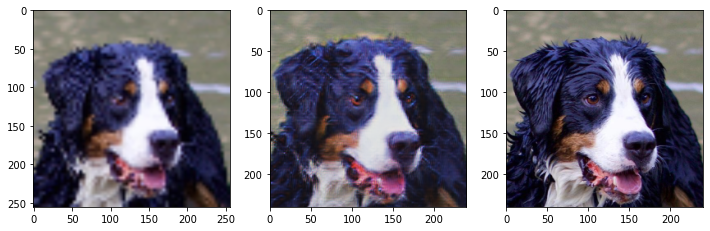

458/458 [==============================] - 194s 424ms/step - loss: 2.5507
Epoch 99/100
458/458 [==============================] - ETA: 0s - loss: 2.5505

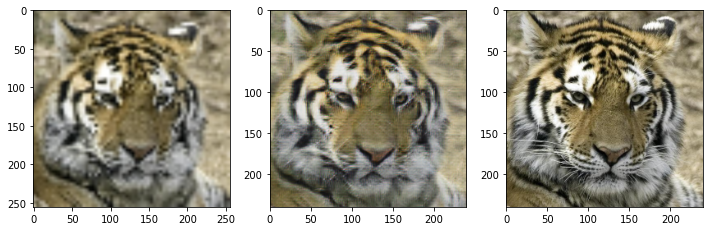

458/458 [==============================] - 194s 424ms/step - loss: 2.5505
Epoch 100/100
458/458 [==============================] - ETA: 0s - loss: 2.5505
Epoch 00100: ReduceLROnPlateau reducing learning rate to 9.765624753299562e-08.
Buffered data was truncated after reaching the output size limit.

In [19]:
# checkpoints for various stuff

percep_ckpt = ModelCheckpoint('/content/drive/My Drive/Single_Image_SR/SR_percep.h5',monitor = 'loss',save_best_only=True,mode = 'min')
early_stop_cb = EarlyStopping(monitor='loss',
                           min_delta=1e-6,
                           patience=3,
                           mode='min',
                           verbose=1)
lr_reduce = ReduceLROnPlateau(monitor = 'loss',factor = decay_plateau,patience = 0,min_lr = 1e-8,verbose = 1)
def plot(epoch,train = train_3): # change the generator if needed
    x,pred = train[np.random.randint(0,len(train)-1)]
    y = SR.model.predict(x)
    idx = np.random.randint(0,train.batch_size)
    in_img = (x[idx]*255).astype(np.uint8)
    out_img = (y[idx]*255).astype(np.uint8)
    truth = (pred[idx]*255).astype(np.uint8)
    fig=plt.figure(figsize=(12, 4))
    fig.add_subplot(1,3,1)
    plt.imshow(in_img[:,:,::-1])
    fig.add_subplot(1,3,2)
    plt.imshow(out_img[:,:,::-1])
    fig.add_subplot(1,3,3)
    plt.imshow(truth[:,:,::-1])
    plt.show()


    
show_visual = LambdaCallback(
    on_epoch_end= lambda epoch,logs:  plot(epoch)
)
callback = [percep_ckpt,early_stop_cb,lr_reduce,show_visual]



# Train the model on level 1
SR.model.fit(x = train_3,
             epochs = 100,
             callbacks = callback)

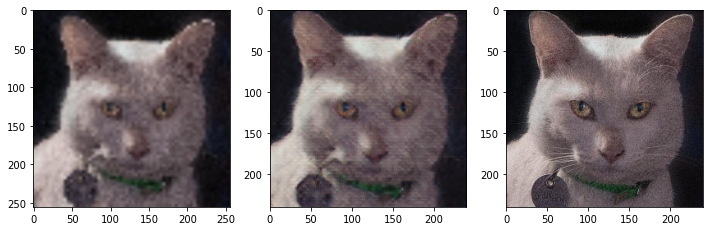